<a href="https://colab.research.google.com/github/pratikjori20/Appliance-Energy-Prediction/blob/main/ML_Regression_Capstone_project_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name**    - **Appliance Energy Prediction**



##### **Project Type**    - Regression
##### **Contribution**    - Team
##### **Team Member 1 -** Pratik D Jori
##### **Team Member 2 -** Pritesh Tambat

# **Project Summary -**

Modern world is depended on the reliable and affordable delivery of the electricity. Yet it affected power outages in many places in world. One of the main reasons of power outage is overloading.
Overloading occurs when too much of energy is drown from the electric circuit at once. This can be avoided by knowing that the excess of power consumption of electricity. Most of the energy is consumed by the heating and cooling appliances in household.
The dataset which is provided by AlmaBetter is consist energy of appliances, light fixture in the house, temperature, humidity in different room. And it can be monitored by the wireless sensor network. Regression model is used in this for prediction the energy use of appliances.

The main goal is predicting the energy use in household based on internal and external temperature and humidity. Each observation measures energy consumption in 10-minute interval, the temperature and humidity have been averaged for 10-minute intervals.


Data-driven prediction of energy use of appliances the data set is at 10 min for about 4.5 months. The house temperature and humidity conditions were monitored with a ZigBee wireless sensor network. Each wireless node transmitted the temperature and humidity conditions around 3.3 min. Then, the wireless data was averaged for 10 minutes periods. The energy data was logged every 10 minutes with m-bus energy meters. Weather from the nearest airport weather station (Chievres Airport, Belgium) was downloaded from a public data set from Reliable Prognosis (rp5.ru) and merged together with the experimental data sets using the date and time column. Two random variables have been included in the data set for testing the regression models and to filter out non-predictive attributes (parameters).

The problem statement is to build the machine learning model that could predict the energy consumption of the Appliances

The first step is to import the all-necessary library to execute and import the data set given by the Almabetter then we check the null and missing values in the data, clean the data further we convert the date column in the Dtype as datetime64, then we check the basic statistical description of the data.

The second step exploratory data analysis where we dig into the data as mean energy consumption, trends of energy consumption, target distribution, feature distribution and plot the heatmaps, correlation matrix of all attributes. Further we check outliers and also treated outliers.

The third step we have try some machine learning algorithms on our train test splitted and standardize data we tried Linear regression, Ridge regression, Lasso regression, Polynomial regression, Decision tree regression. We done model implementation and parameter tunning, and also, we implement the feature importance technique to understand the which is important feature

The best performance has given by the Decision Tree regression model where RMSE is low as compare to other algorithms.
Top three features are humidity attributes which means the humidity affect the more power consumption than the temperature.

We can do hyperparameter tunning to deploy better algorithm such as support vector regressor, gradient boosting, neural networks etc.
So, the controlling humidity inside the house may save the energy consumption.
The dataset is mainly focus on datetime so we can approach the ‘time series analysis’ problem to forecast the consumption of energy.


 


# **GitHub Link -**

Pratik’s Github link:- https://github.com/pratikjori20/Appliance-Energy-Prediction

Pritesh’s Github link:- https://github.com/pritesh2292/Appliance-Energy-Prediction



# **Problem Statement**


**Problem Overview**

The energy consume by home appliances are significant amount of the owner’s budget. Consumers are looking to improve the energy efficiency and reduce the costs.
Demand of the electricity is increasing significantly as the world population has growth over 8 billion.
The objective is to build a predictive model which will help to predict the total consumption of energy from home appliances.
Appliance energy consumption based on factor like temperature, humidity, pressure, many techniques gradient descent algorithm, and linear regression have been applied to predict the energy consumption.
Predict the electricity consumption heating and cooling appliances in household based on internal and external temperature and other weather condition.

# **General Guidelines** : -  

1.   Well-structured, formatted, and commented code is required. 
2.   Exception Handling, Production Grade Code & Deployment Ready Code will be a plus. Those students will be awarded some additional credits. 
     
     The additional credits will have advantages over other students during Star Student selection.
       
             [ Note: - Deployment Ready Code is defined as, the whole .ipynb notebook should be executable in one go
                       without a single error logged. ]

3.   Each and every logic should have proper comments.
4. You may add as many number of charts you want. Make Sure for each and every chart the following format should be answered.
        

```
# Chart visualization code
```
            

*   Why did you pick the specific chart?
*   What is/are the insight(s) found from the chart?
* Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

5. You have to create at least 15 logical & meaningful charts having important insights.


[ Hints : - Do the Vizualization in  a structured way while following "UBM" Rule. 

U - Univariate Analysis,

B - Bivariate Analysis (Numerical - Categorical, Numerical - Numerical, Categorical - Categorical)

M - Multivariate Analysis
 ]





6. You may add more ml algorithms for model creation. Make sure for each and every algorithm, the following format should be answered.


*   Explain the ML Model used and it's performance using Evaluation metric Score Chart.


*   Cross- Validation & Hyperparameter Tuning

*   Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

*   Explain each evaluation metric's indication towards business and the business impact pf the ML model used.




















# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [1]:
# Import Libraries
# Import all necessary Libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
%matplotlib inline

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn import preprocessing, model_selection, metrics
from sklearn import datasets, linear_model, metrics
from sklearn import ensemble
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
import xgboost as xgb
from sklearn.svm import SVR
from math import sqrt

import time
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import warnings
warnings.filterwarnings('ignore')

### Dataset Loading

In [2]:
# Load Dataset
# mount the drive on colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# read the data
path = "/content/drive/MyDrive/Copy of data_application_energy.csv"
df = pd.read_csv(path, parse_dates=['date']) # to change the date dtype as datetime using parse_dates.

### Dataset First View

In [4]:
# Dataset First Look
df.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


### Dataset Rows & Columns count

In [5]:
# Dataset Rows & Columns count
df.shape

(19735, 29)

In [6]:
print('The number of rows in dataset is - ' , df.shape[0])
print('The number of columns in dataset is - ' , df.shape[1])

The number of rows in dataset is -  19735
The number of columns in dataset is -  29


### Dataset Information

In [7]:
# Dataset Info
df_1 = df
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         19735 non-null  datetime64[ns]
 1   Appliances   19735 non-null  int64         
 2   lights       19735 non-null  int64         
 3   T1           19735 non-null  float64       
 4   RH_1         19735 non-null  float64       
 5   T2           19735 non-null  float64       
 6   RH_2         19735 non-null  float64       
 7   T3           19735 non-null  float64       
 8   RH_3         19735 non-null  float64       
 9   T4           19735 non-null  float64       
 10  RH_4         19735 non-null  float64       
 11  T5           19735 non-null  float64       
 12  RH_5         19735 non-null  float64       
 13  T6           19735 non-null  float64       
 14  RH_6         19735 non-null  float64       
 15  T7           19735 non-null  float64       
 16  RH_7

#### Duplicate Values

In [8]:
# Dataset Duplicate Value Count
df.duplicated().value_counts()

False    19735
dtype: int64

#### Missing Values/Null Values

In [9]:
# Missing Values/Null Values Count
# Checking for null values

df.isnull().sum()

date           0
Appliances     0
lights         0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T6             0
RH_6           0
T7             0
RH_7           0
T8             0
RH_8           0
T9             0
RH_9           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
dtype: int64

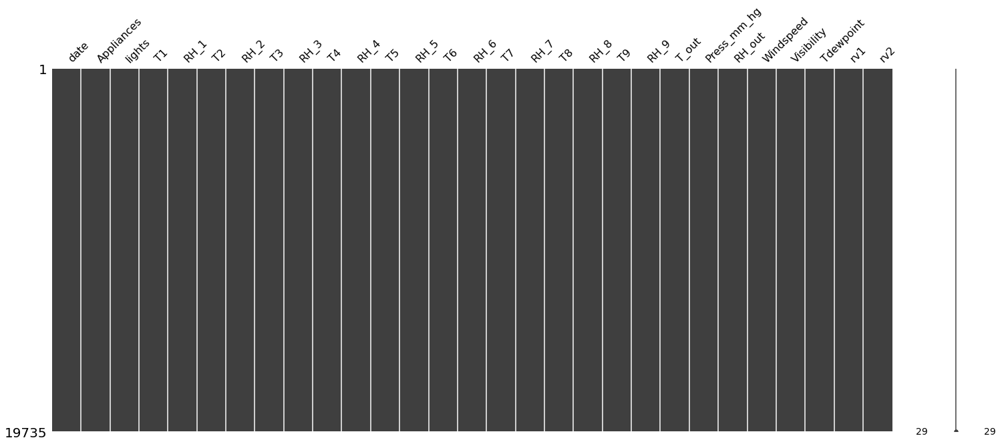

In [10]:
# Visualizing the missing values
msno.matrix(df);  #visualizing the missing value as matrix

### What did you know about your dataset?

The given dataset is collection of temperature, humidity and pressure attributes from the sensors in the room and outside the room at regular interval of 10 minutes for 4.5 months.

By looking at the first at dataset we know that, the it has 29 columns and 19735 are rows. The data is in form of the numeric as it has float and int data type there is no duplicates and non null values so we can procced further.


## ***2. Understanding Your Variables***

In [11]:
# Dataset Columns
df.columns

Index(['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2'],
      dtype='object')

In [12]:
# Dataset Describe
df.describe(include = 'all')

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
unique,19735,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,2016-01-11 17:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
first,2016-01-11 17:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2016-05-27 18:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,...,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,NaN,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,...,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,NaN,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,NaN,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,...,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889


### Variables Description 

* date : time year-month-day hour:minute:second
* lights : energy use of light fixtures in the house in Wh
* T1 : Temperature in kitchen area, in Celsius
* T2 : Temperature in living room area, in Celsius
* T3 : Temperature in laundry room area
* T4 : Temperature in office room, in Celsius
* T5 : Temperature in bathroom, in Celsius
* T6 : Temperature outside the building (north side), in Celsius
* T7 : Temperature in ironing room, in Celsius
* T8 : Temperature in teenager room 2, in Celsius
* T9 : Temperature in parents’ room, in Celsius
* T_out : Temperature outside (from Chievres weather station), in Celsius
* Tdewpoint : (from Chievres weather station), Â°C
* RH_1 : Humidity in kitchen area, in %
* RH_2 : Humidity in living room area, in %
* RH_3 : Humidity in laundry room area, in %
* RH_4 : Humidity in office room, in %
* RH_5 : Humidity in bathroom, in %
* RH_6 : Humidity outside the building (north side), in %
* RH_7 : Humidity in ironing room, in %
* RH_8 : Humidity in teenager room 2, in %
* RH_9 : Humidity in parents’ room, in %
* RH_out : Humidity outside (from Chievres weather station), in %
* Pressure : (from Chievres weather station), in mm Hg
* Wind speed: (from Chievres weather station), in m/s
* Visibility :(from Chievres weather station), in km
* Rv1 :Random variable 1, non-dimensional
* Rv2 :Random variable 2, non-dimensional
* Appliances : Total energy used by appliances, in Wh



### Check Unique Values for each variable.

In [13]:
# Check Unique Values for each variable.
df.nunique()

date           19735
Appliances        92
lights             8
T1               722
RH_1            2547
T2              1650
RH_2            3376
T3              1426
RH_3            2618
T4              1390
RH_4            2987
T5              2263
RH_5            7571
T6              4446
RH_6            9709
T7              1955
RH_7            5891
T8              2228
RH_8            6649
T9               924
RH_9            3388
T_out           1730
Press_mm_hg     2189
RH_out           566
Windspeed        189
Visibility       413
Tdewpoint       1409
rv1            19735
rv2            19735
dtype: int64

## 3. ***Data Wrangling***

### Data Wrangling Code

In [14]:
# Write your code to make your dataset analysis ready.

# Set the date index
df = df.set_index('date')

In [15]:
# mount the columns for date type
df['Month'] = df.index.month
df['Weekday'] = df.index.weekday
df['Day'] = df.index.day
df['Hour'] = df.index.hour
df['Week'] = df.index.week

### What all manipulations have you done and insights you found?

As we know the data collected in 10 min intervels for 4.5 months so the time is important factor in this data set so we have mount the columns for month, weekday, day, hours and week for better visualization.

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

#### Chart - 1 - Energy Conumption per Day of the Week (Bivariate)

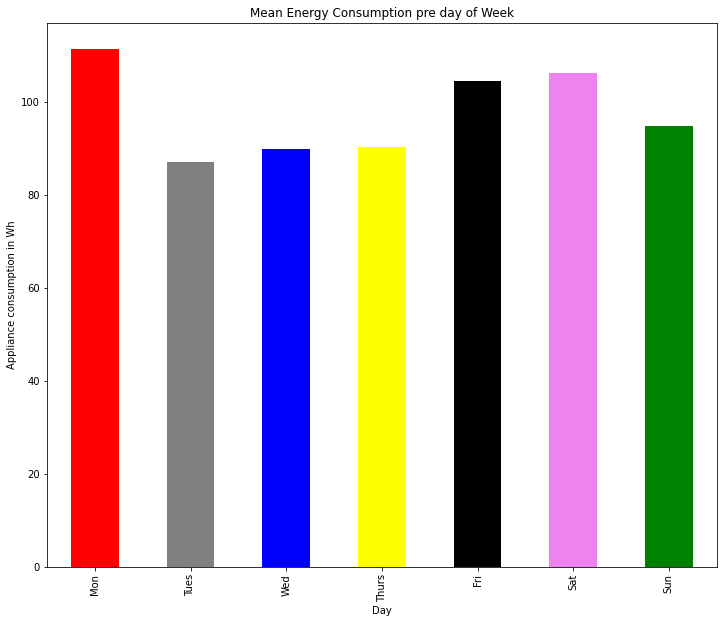

In [16]:
# Chart - 1 visualization code

# function to be used for plotting
def daily(x, energy_df=df):
  return energy_df.groupby('Weekday')[x].mean()

def hourly(x, energy_df=df):
  return energy_df.groupby('Hour')[x].mean()

def monthly_daily(x, energy_df=df):
  by_day = energy_df.pivot_table(index='Weekday', columns=['Month'], values=x, aggfunc='mean')
  return round(by_day, ndigits=2)
  
# plot of mean energy consumption per day of week

daily('Appliances').plot(kind = 'bar', color=['red','grey','blue','yellow','black','violet','green'], figsize = (12,10))
ticks = list(range(0,7,1))
labels = "Mon Tues Wed Thurs Fri Sat Sun".split()
plt.xlabel('Day')
plt.ylabel('Appliance consumption in Wh')
plt.title('Mean Energy Consumption pre day of Week')
plt.xticks(ticks, labels);

##### 1. Why did you pick the specific chart?

We want to know how much energy has been consumed by the appliances on the perticular day of the week.

##### 2. What is/are the insight(s) found from the chart?

From the graph we found out that the energy consumption on monday, friday and saturday is higher than the other day of week.






##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

The mean energy consumption per day of week chart shows that the weekend and the monday this are the days where appliances are used most of the energy so we can say that the on this day the members of house are present in the room and they are used the appliances more so avoiding the usage of uneccessory will tends to less the consumption of energy so awerness in the family member will help to reduce energy consumption. for that chart will usefull. so it will be help to creat a positive business impact.

#### Chart - 2 - Energy Consumption per Hour of the Day (Bivariate)

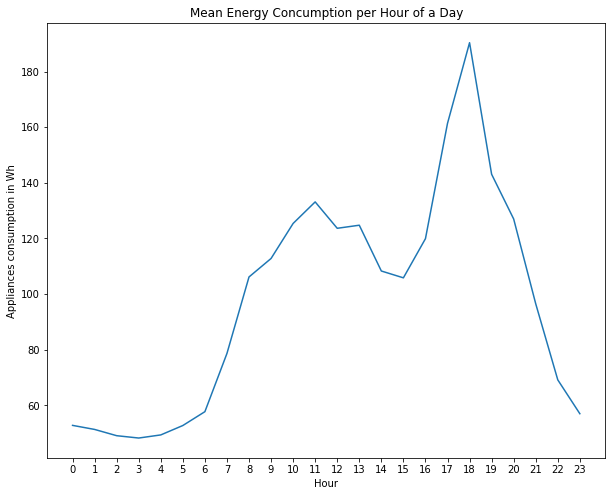

In [17]:
# Chart - 2 visualization code

# mean energy consumption per hour of the day
hourly('Appliances').plot(figsize = (10,8))
plt.xlabel('Hour')
plt.ylabel('Appliances consumption in Wh')
ticks = list(range(0,24,1))
plt.title('Mean Energy Concumption per Hour of a Day')
plt.xticks(ticks);

##### 1. Why did you pick the specific chart?

We want to know how much energy has been consumed in day per hours, the trends shows the ups and downs of the energy consumption per hour of the day.

##### 2. What is/are the insight(s) found from the chart?

From the chart we can see the energy consumption has varies with trends per hours  of the day At night time from 22:00 to 7:00 the energy consumption is below 80Wh, as the most of appliances are off or on stand-by. Between 9:00 to 13:00 the energy consumotion is 120Wh-135Wh and after lunch time reduces again to 110Wh at afternoon, the energy consumption is 130Wh-185Wh as family members are at home and many devices are on. 

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

From mean energy consumption per hour of the day chart are showing the trends of the energy uses by the house members at perticular time periods so it can help to know the what time energy is consumed high and the low in the house. so it has positive impact.

#### Chart - 3 - Daily Energy Consumption per Months (Bivariate)

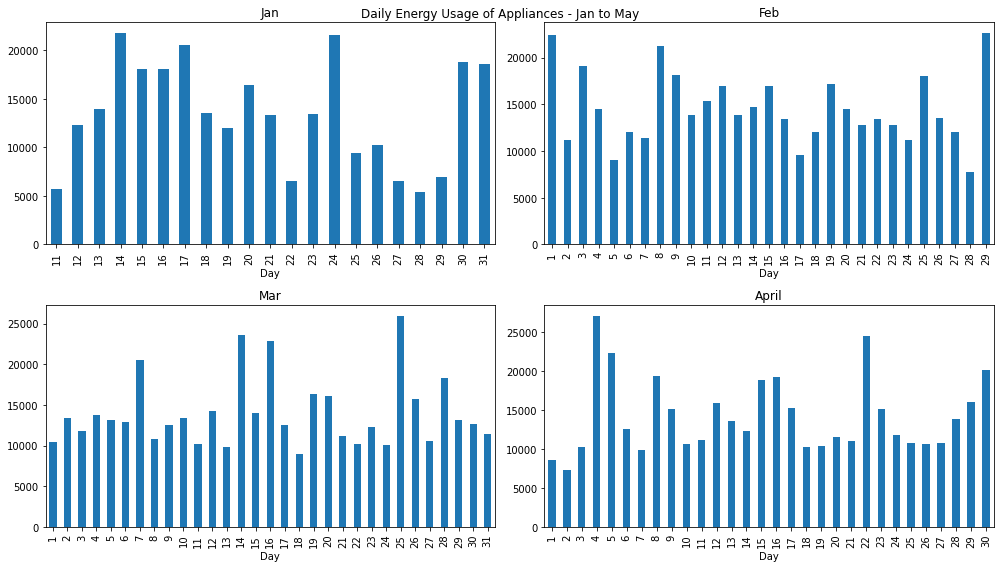

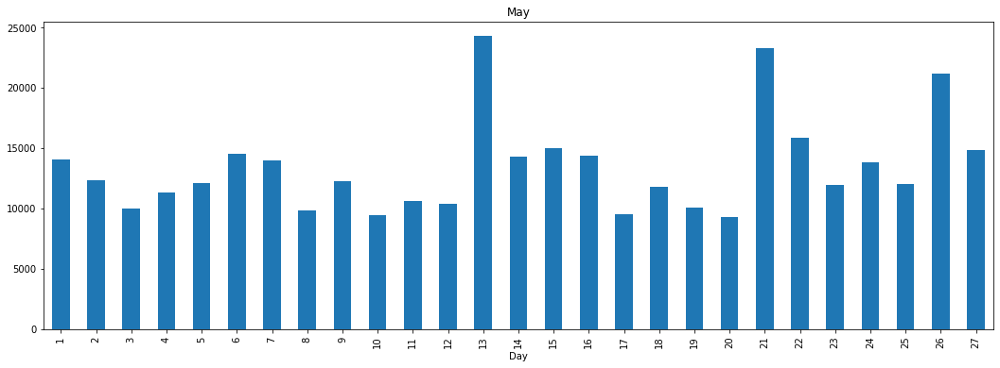

In [18]:
# Chart - 3 visualization code

# daily energy usages of appliances from jan-may
fig, ax = plt.subplots(2,2, figsize=(14,8))
ax = ax.flatten()
months =['Jan', 'Feb', 'Mar', 'April']
for i in range(1,5):
  df.query(f"Month == {i}")[['Day','Appliances']].groupby('Day')['Appliances'].sum().plot.bar(ax=ax[i-1], title = months[i-1])

plt.suptitle('Daily Energy Usage of Appliances - Jan to May')
plt.tight_layout()
plt.show()

plt.figure(figsize = (18,6))
df.query("Month == 5")[['Day','Appliances']].groupby('Day')['Appliances'].sum().plot.bar(title = 'May')
plt.show()

##### 1. Why did you pick the specific chart?

We have seen the mean energy consumption per hours of day and per day of the week so need to know per day of the months so we plot this chart to know daily energy usage of appliances from jan to may.

##### 2. What is/are the insight(s) found from the chart?

From the daily energy usage from january to may we can see that the weekend energy consumption is low or high as compare to average day.

Some of the month are showing higher energy consumption for pre-weekends.

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

From the charts we seen that the energy consumption trend is not same it vaires by month to month the weekend energy consumption is low or high and some months are showing that the energy consumption is higher for pre-weeekends it will impact the negative for the business growth.

#### Chart - 4 - Appliance Distribution (Univariate)

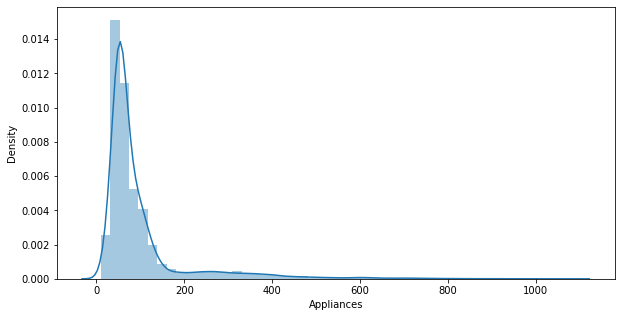

In [19]:
# Chart - 4 visualization code

#target distribution
plt.figure(figsize=(10, 5))
sns.distplot(df['Appliances']);

In [20]:
print('Percentage of dataset in range of 0-200 Wh')
print("{:.3f}%".format((df[df.Appliances <= 200]['Appliances'].count()*100)/df.shape[0]))

Percentage of dataset in range of 0-200 Wh
90.291%


##### 1. Why did you pick the specific chart?

Appliance is the target variable so we need to see the distribution and we check the outlier by this chart.

##### 2. What is/are the insight(s) found from the chart?

Appliance distribution chart shows the positve skewed, and the most of the values are around mean 100 Wh or below 200Wh. there are few cases of high energy consumptio. The percentage of values within range 0f 0-200 Wh is 90.29% and long tailed shows that there is outliers in this columns

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

Distribution of the perticukar variable are helpfull to understand the skewedness  of the data and it helps to find out is there any outliers present in the column.

#### Chart - 5 - Column wise Histogram Univarite Analysis

In [21]:
# Chart - 5 visualization code

# creating copy of data set for better vizulization
drop_df = df
# removing the unecessory columns
drop_df = drop_df.drop('Month', axis=1)
drop_df = drop_df.drop('Weekday', axis=1)
drop_df = drop_df.drop('Week', axis=1)


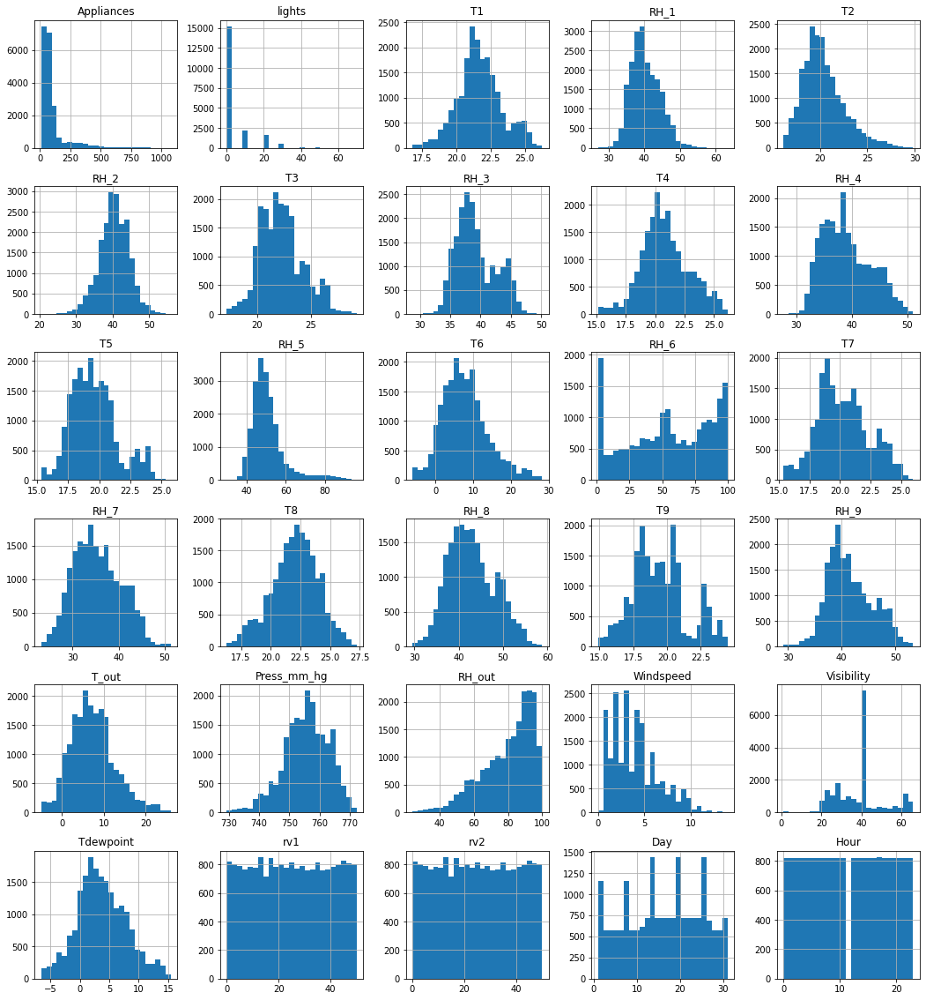

In [22]:
# hist of all the features to undrstand the distribution
drop_df.hist(bins = 25, figsize = (18,20));

##### 1. Why did you pick the specific chart?

This chart is showing the distribution of the all the attributes from the dataset will help to better understanding of the normal distribution or not.

##### 2. What is/are the insight(s) found from the chart?

From the histogram of distribution  of all attributes we know that the,

Almost all Temperature variable follows "Normal Distribution".

Almost all Humidity variable follows "Normal Distribution" except RH_Out and 

RH_6, may be because they were placed outside the house

RH_6 has a quite substatial values in bin[1-1.990] which could be rading from summer months(april/may) of data(Jan-June)

Windspeed column is postively skewed & RH_out is negatively skewed

RH_out, Windspeed & Visibility contains outliers

Appliance column is postively skewed with most of the values around mean 100 Wh

The displots for RH_6, RH_out, Visibility, Windspeed are in focussed due to irregular distribution. It help us to visualize the data better.



##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

The distribution of all input variables are help to understand the data more visually than the reading and it will help in read the data quickly and focous on the negative factors such as outliers and negatively skewed distribution and improve it for getting better performance from the algoritham model which will we are implemented further.

#### Chart - 6 - Energy Consumption Distribution by the Appliances & log_appliance (Univariate)

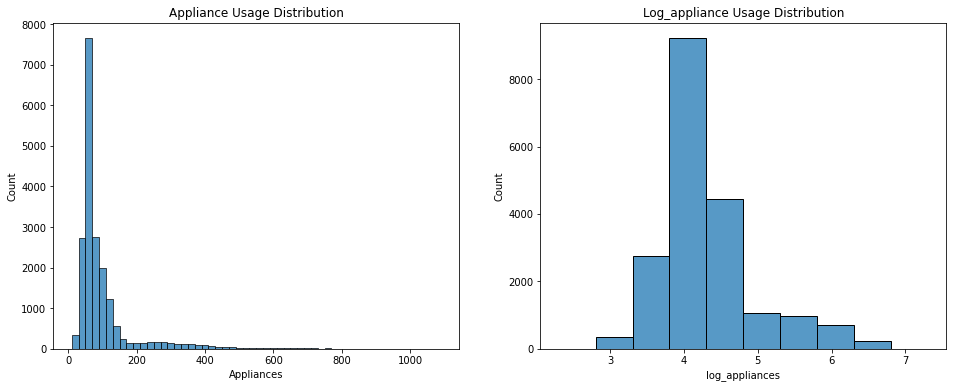

In [23]:
# Chart - 6 visualization code

# target variable shows long right tailed skewed so we done log of the appliance variable to achive better result
drop_df['log_appliances'] = np.log(drop_df.Appliances)

#ploting the log_appliance energy consumptions
fig, ax = plt.subplots(1,2, figsize=(16,6))

sns.histplot(x='Appliances', data=drop_df, binwidth=20, ax=ax[0])
sns.histplot(x='log_appliances', data=drop_df, binwidth=0.5, ax=ax[1])

ax[0].set_title('Appliance Usage Distribution')
ax[1].set_title('Log_appliance Usage Distribution')

plt.show()

##### 1. Why did you pick the specific chart?

Appliance shows the long tailed right skewed distribution as the appliances is the target variable so we need to get better result we done log of appliances and treated the outlier

##### 2. What is/are the insight(s) found from the chart?

From the energy consumption distribution of appliances and log_appliances we get the better view of the energy consumption distribution as the appliances distribution has some outlier by doing log we neglected it for better performance.

Appliance hist plot of time series, it shown seasonality component is decreasing it may suggest an exponential decrease from season to season. A log transform can be used to flatten out exponential changes to linear relationship.

We are looking at the mean and variance, we are assume that the data conform Gaussian(bell or normal curve). Appliance log histogram plot from the time series the ball curve-like shape of the Gaussian distribution, perhaps with longer right tail.

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

Appliances energy consumption distribution has some outliers and it will affect the performance of the regression algoritham model so the doing log of appliance disribution will help to get better performance by treating the outliers.

#### Chart - 7- Heatmap

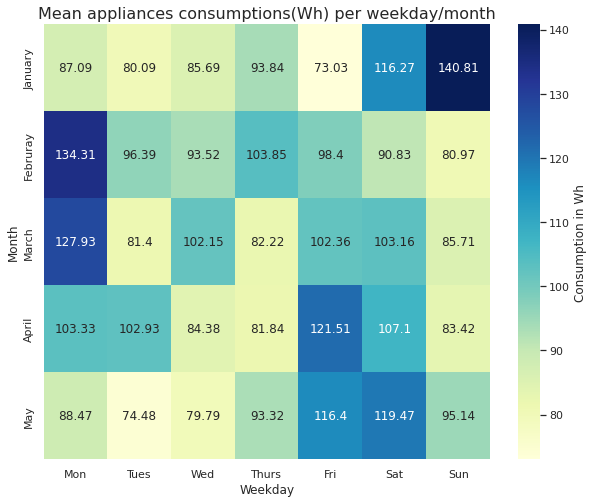

In [24]:
# Chart - 7 visualization code

# heatmap mean appliance consumption per weekday of month
sns.set(rc={'figure.figsize':(10,8)})
ax = sns.heatmap(monthly_daily('Appliances').T,cmap='YlGnBu',
                 xticklabels= 'Mon Tues Wed Thurs Fri Sat Sun'.split(),
                 yticklabels= 'January Februray March April May'.split(),
                 annot=True, fmt='g',
                 cbar_kws= {'label': 'Consumption in Wh'}).set_title('Mean appliances consumptions(Wh) per weekday/month').set_fontsize('16')
plt.show()

##### 1. Why did you pick the specific chart?

The heatmap between the month and weekday shows the energy consumption in Wh.
it will help to know the when energy consumption is high or low

##### 2. What is/are the insight(s) found from the chart?

From the heatmap of applainces energy consumption per weekday of the months that the more power is consumed on mon, fri, sat and sun is valid for each month, however in this dataset we have only 4.5 months and from that we can't use months as feature for our model.

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

Heatmap is better visualisation of any dataset to better understanding and quick read of data in here, we findout that on which days of months the appliance enegy consumption is high and on which day it is low or avarage hence it is helpfull for business prespective. 

#### Chart - 8 - Correlation Heatmap

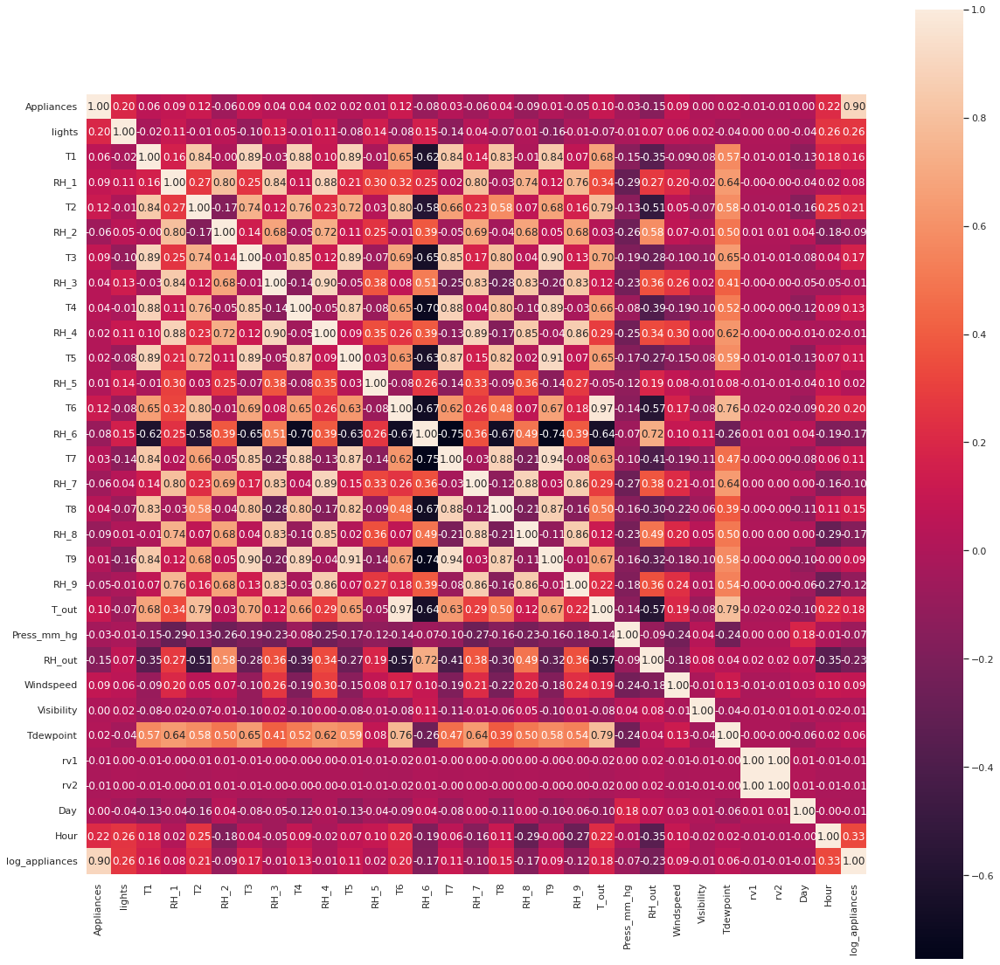

In [25]:
# Chart - 8 visualization code

# plotting correlation matrix
corr = drop_df.corr()
plt.figure(figsize = (20,20))
sns.set(font_scale = 1)
sns.heatmap(corr, cbar=True, annot=True, square=True, fmt='.2f')
plt.show()

##### 1. Why did you pick the specific chart?

Correlation heatmaps used to find potential relationships between variables and to understand the strength of these relationships. A correlation plot contains a number of numerical variables, with each variable represented by a column. The rows can be used to show the relationship between each pair of variables. so for knowing the correlation between all variable we usse correlation matrix

##### 2. What is/are the insight(s) found from the chart?

From the correlation heatmap we know that the,
The most correlated feature with energy consumption log_appliances are hours: 0.33, lights: 0.26, t6: 0.26, t2: 0.22, t3: 0.17, t_out: 0.18, rh_out: -0.23, rh_8: -0.17, rh_6: -0.18, windspeed: 0.09.
From this we examine linear dependence among some basic feature in this dataset. In linear regression problem only, linear independent variables can be used as feature to explain consumption in other way we will have multicollinearity issue.

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

The cells indicate the strength of the relationship, with positive values indicating a positive and negative values indicating a negative relationship. correlation coefficient help to understand the strength of the relationships between variables.

#### Chart - 9 - Pair Plot

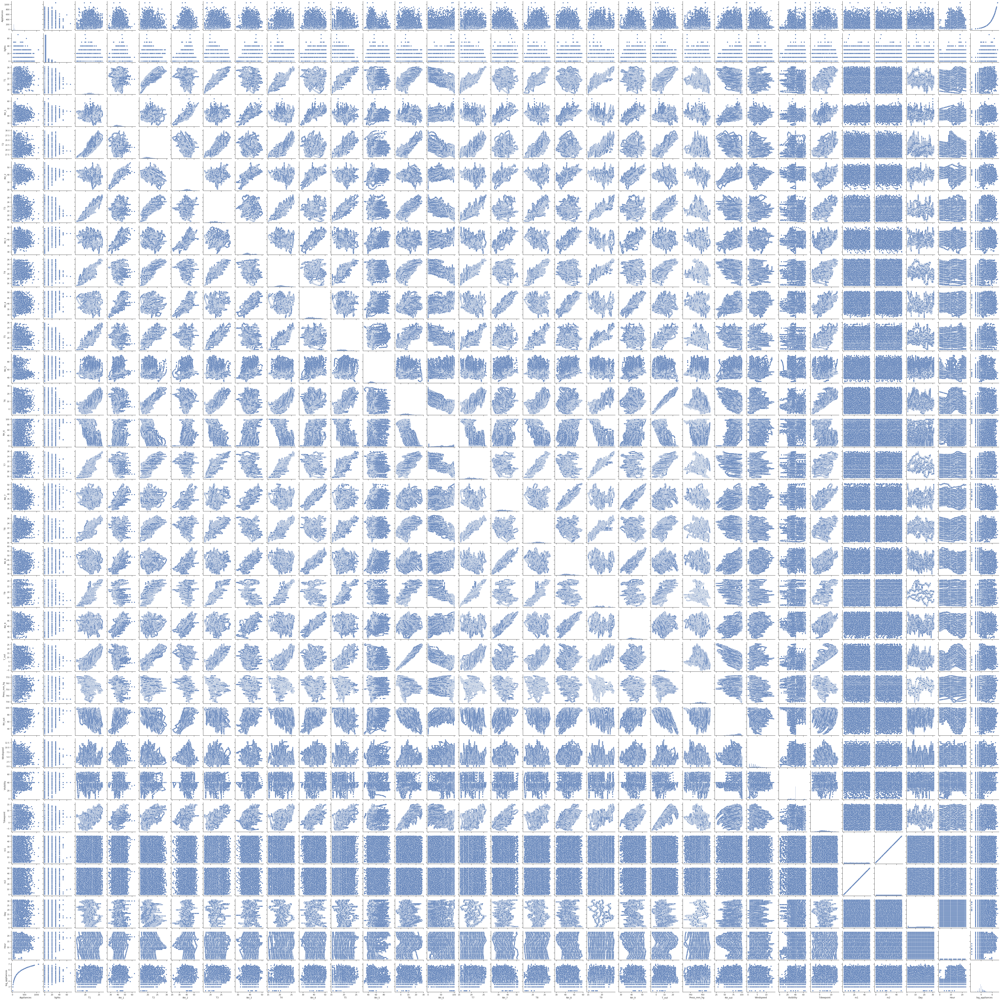

In [26]:
# Chart - 9 visualization code

sns.set(style = 'ticks', color_codes=True)
sns.pairplot(drop_df)
plt.show();

##### 1. Why did you pick the specific chart?

This chart is used to understand the relation between the two variables and also help to simplify the classification models by drawing the lines of dataset. We used the pair plot to analyse the patterns of data and relationship between variables. 

##### 2. What is/are the insight(s) found from the chart?

Pair plot is the same represantation of correlation coefficient but it is in the graphical form and in the most separated clusters. Here in temperature attributes there is significant correleation between column T7 and T9, and in humidity attributes there is no such significant correlation and the weather data attributes are uncorrelated to each other.

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

From this pair plot we find out that the which attributes columns are correlated to each other and it will help in buliding the good model

#### Chart - 10

In [27]:
# Chart - 10 visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 11

In [28]:
# Chart - 11 visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 12

In [29]:
# Chart - 12 visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 13

In [30]:
# Chart - 13 visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 14 - Correlation Heatmap

In [31]:
# Correlation Heatmap visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

#### Chart - 15 - Pair Plot 

In [32]:
# Pair Plot visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

## ***5. Hypothesis Testing***

### Based on your chart experiments, define three hypothetical statements from the dataset. In the next three questions, perform hypothesis testing to obtain final conclusion about the statements through your code and statistical testing.


1.Checking the correleation between temperature variables T7 and T9.

2.Let's calculate the which temperature attributes pairs have high degree of correlation (>0.9)



### Hypothetical Statement - 1

In [33]:
from pandas.core.arrays.timedeltas import precision_from_unit
# Perform Statistical Test to obtain P-Value
from scipy.stats import pearsonr

# calculating the coefficient and p-value
corr_coef, p_value = pearsonr(df['T7'], df['T9'])
print('correlation coefficient:{}'.format(corr_coef))
print('p_value:{}'.format(p_value))

correlation coefficient:0.9447764235687444
p_value:0.0


#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Checking the correleation between temperature variables T7 and T9.

#### 2. Perform an appropriate statistical test.

##### Which statistical test have you done to obtain P-Value?

We used the pearsonr technique as we finiding the correleation between variables and pearsonr given roughly probabililty of uncorrelated system producing dataset. From pair plot we know that the T7 and T9 are significantly correlated so we check the correlation statistically from that we see that there is very high degree of positive correlation between this two columns, Also the p-value is less than 0.01 therefore, we can reject the null hypothesis.

Answer Here.

##### Why did you choose the specific statistical test?

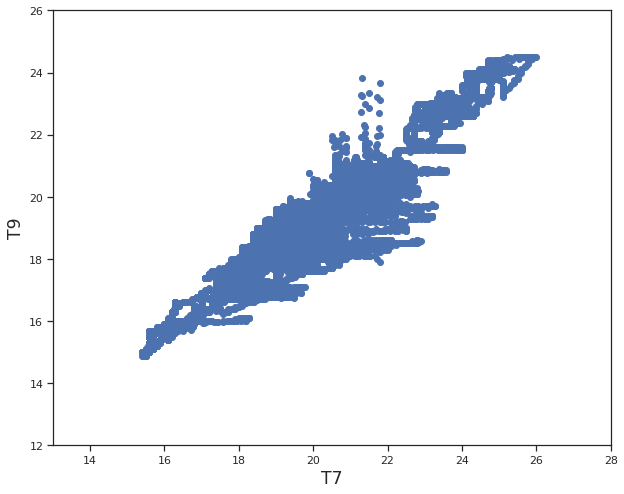

In [34]:
# visualize the correaltion between T7 and T9 with scatter plot

plt.xlabel('T7', fontsize='x-large')
plt.ylabel('T9', fontsize='x-large')

plt.xlim(int(df.T7.min()) - 2, int(df.T7.max()) + 2)
plt.ylim(int(df.T9.min()) - 2, int(df.T9.max()) + 2)
plt.scatter(df['T7'],df['T9']);

from pair plot we know that the T7 and T9 are significantly correlated so we check the correlation statistically from that we see that there is very high degrre of positive correlation between this two columns, Also the p-value is less than 0.01 therefore, we can reject the null hypothesis.

### Hypothetical Statement - 2

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.



Let's calculate the which temperature attributes pairs have high degree of correlation (>0.9)

#### 2. Perform an appropriate statistical test.

In [35]:
#creating the temperature columns separtley for better understanding

temp = ['T1', 'T2', 'T3', 'T4', 'T5', 'T6', 'T7', 'T8', 'T9', 'T_out']
data = df[temp]

In [36]:
# Perform Statistical Test to obtain P-Value
# to creat all pairs for given columns
from itertools import combinations

for pair in combinations(data.columns, 2):
  col_1, col_2 = pair
  # calculating the correlation and p-value
  corr_coef, p_val = pearsonr(data[col_1], data[col_2])
  # check for high correlation
  if corr_coef > 0.9 or corr_coef < -0.9:
    print('Column pair :{},{}'.format(*pair))
    print('Correlation coefficient :{}'.format(corr_coef))
    print('p-value :{}'.format(p_val))

Column pair :T3,T9
Correlation coefficient :0.901323585082566
p-value :0.0
Column pair :T5,T9
Correlation coefficient :0.9110551178067935
p-value :0.0
Column pair :T6,T_out
Correlation coefficient :0.9747866900664539
p-value :0.0
Column pair :T7,T9
Correlation coefficient :0.9447764235687444
p-value :0.0


##### Which statistical test have you done to obtain P-Value?

Here also we used the same pearsonr method as we calculate the which temperature attributes pairs have high degree of correlation (>0.9). From that we find out three columns are having the correlation with T9, all of have p-value < 0.01. Therefore, T9 is considered as redundant. and very high correlation between T6 and T_out. as it T6 is reading the temperature from the sensor kept outside the building and T_out is temperature obtained from the weather station.

##### Why did you choose the specific statistical test?

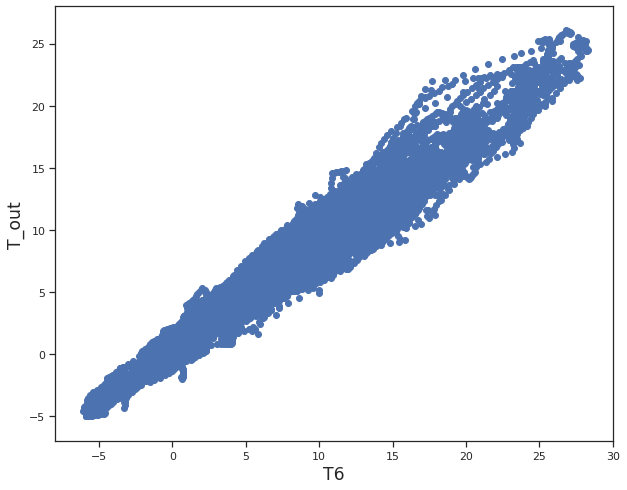

In [37]:
# plotting the scatter plot to show the correlation between high correlated columns

plt.xlabel('T6', fontsize='x-large')
plt.ylabel('T_out', fontsize='x-large')

plt.xlim(int(df.T6.min()) - 2, int(df.T6.max()) + 2)
plt.ylim(int(df.T_out.min()) - 2, int(df.T_out.max()) + 2)

plt.scatter(df['T6'],df['T_out']);

T6 and T_out showing the very high degree of correlation and it is evident from the plot.

### Hypothetical Statement - 3

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

#### 2. Perform an appropriate statistical test.

##### Which statistical test have you done to obtain P-Value?

Answer Here.

##### Why did you choose the specific statistical test?

Answer Here.

## ***6. Feature Engineering & Data Pre-processing***

### 1. Handling Missing Values

In [38]:
# Handling Missing Values & Missing Value Imputation
drop_df.isnull().sum()

Appliances        0
lights            0
T1                0
RH_1              0
T2                0
RH_2              0
T3                0
RH_3              0
T4                0
RH_4              0
T5                0
RH_5              0
T6                0
RH_6              0
T7                0
RH_7              0
T8                0
RH_8              0
T9                0
RH_9              0
T_out             0
Press_mm_hg       0
RH_out            0
Windspeed         0
Visibility        0
Tdewpoint         0
rv1               0
rv2               0
Day               0
Hour              0
log_appliances    0
dtype: int64

#### What all missing value imputation techniques have you used and why did you use those techniques?

There is not any missing values to treated.

### 2. Handling Outliers

The number of the 0, 1% top values of appliances' load is 19 and they have power load higher than 790 Wh


Text(0.5, 1.0, 'Appliances energy consumption distribution')

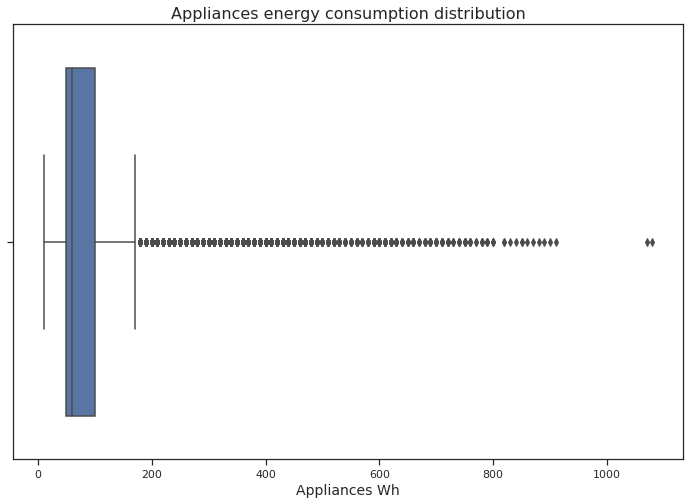

In [39]:
# Handling Outliers & Outlier treatments
# finding the outliers
sorted_appliances = df.sort_values('Appliances', ascending = False)
print("The number of the 0, 1% top values of appliances' load is",
      len(sorted_appliances.head(len(sorted_appliances)//1000)),
      "and they have power load higher than", sorted_appliances.Appliances[19],
      "Wh")

#boxplot for appliances energy consumption
plt.figure(figsize =(12,8))
sns.boxplot(x='Appliances', data=df)
plt.xlabel('Appliances Wh', fontsize=14)
plt.title('Appliances energy consumption distribution', fontsize=16)

In [40]:
#removal of outliers
drop_df = df.drop(df[(df.Appliances>790)|(df.Appliances<0)].index)
drop_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 19718 entries, 2016-01-11 17:00:00 to 2016-05-27 18:00:00
Data columns (total 33 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Appliances   19718 non-null  int64  
 1   lights       19718 non-null  int64  
 2   T1           19718 non-null  float64
 3   RH_1         19718 non-null  float64
 4   T2           19718 non-null  float64
 5   RH_2         19718 non-null  float64
 6   T3           19718 non-null  float64
 7   RH_3         19718 non-null  float64
 8   T4           19718 non-null  float64
 9   RH_4         19718 non-null  float64
 10  T5           19718 non-null  float64
 11  RH_5         19718 non-null  float64
 12  T6           19718 non-null  float64
 13  RH_6         19718 non-null  float64
 14  T7           19718 non-null  float64
 15  RH_7         19718 non-null  float64
 16  T8           19718 non-null  float64
 17  RH_8         19718 non-null  float64
 18  T9         

##### What all outlier treatment techniques have you used and why did you use those techniques?

Appliances are the target variables and it containes the outliers we need to treat the outlier as it is important variable. 

The number of the top values of appliance load is 19 and they have power load higher than 790Wh. So, we remove the instances above 790Wh. by applying drop technique.

### 3. Categorical Encoding

In [41]:
# Encode your categorical columns

#### What all categorical encoding techniques have you used & why did you use those techniques?

Answer Here.

### 4. Textual Data Preprocessing 
(It's mandatory for textual dataset i.e., NLP, Sentiment Analysis, Text Clustering etc.)

#### 1. Expand Contraction

In [42]:
# Expand Contraction

#### 2. Lower Casing

In [43]:
# Lower Casing

#### 3. Removing Punctuations

In [44]:
# Remove Punctuations

#### 4. Removing URLs & Removing words and digits contain digits.

In [45]:
# Remove URLs & Remove words and digits contain digits

#### 5. Removing Stopwords & Removing White spaces

In [46]:
# Remove Stopwords

In [47]:
# Remove White spaces

#### 6. Rephrase Text

In [48]:
# Rephrase Text

#### 7. Tokenization

In [49]:
# Tokenization

#### 8. Text Normalization

In [50]:
# Normalizing Text (i.e., Stemming, Lemmatization etc.)

##### Which text normalization technique have you used and why?

Answer Here.

#### 9. Part of speech tagging

In [51]:
# POS Taging

#### 10. Text Vectorization

In [52]:
# Vectorizing Text

##### Which text vectorization technique have you used and why?

Answer Here.

### 4. Feature Manipulation & Selection

#### 1. Feature Manipulation

In [53]:
# Manipulate Features to minimize feature correlation and create new features

#### 2. Feature Selection

In [54]:
# Select your features wisely to avoid overfitting
# managing the column
temperature = ['T1', 'T2', 'T3', 'T4', 'T5', 'T6', 'T7', 'T8', 'T9']
humidity = ['RH_1', 'RH_2', 'RH_3', 'RH_4', 'RH_5', 'RH_6', 'RH_7', 'RH_8', 'RH_9']
weather = ['T_out', 'Tdewpoint', 'RH_out', 'Press_mm_hg', 'Windspeed', 'Visibility']
lights = ['lights']
hour = ['Hour']
random = ['rv1', 'rv2']
appliance = ['Appliances']
app_class = ['Appliances_class']

In [55]:
# creating the feature and target variable
feature_v = drop_df[temperature + humidity + weather + random]
target_v = drop_df[appliance]

##### What all feature selection methods have you used  and why?

We divided the columns based on there types for clear column management

##### Which all features you found important and why?

Temperature humidity this are important factor that affect the use of appliances hence the energy consummption by the appliances also weather is also imprtant feature for effect the energy consumption by appliances.

### 5. Data Transformation

#### Do you think that your data needs to be transformed? If yes, which transformation have you used. Explain Why?

In [56]:
# Transform Your data

### 6. Data Scaling

In [57]:
# Scaling your data

##### Which method have you used to scale you data and why?

### 7. Dimesionality Reduction

##### Do you think that dimensionality reduction is needed? Explain Why?

Answer Here.

In [58]:
# DImensionality Reduction (If needed)

##### Which dimensionality reduction technique have you used and why? (If dimensionality reduction done on dataset.)

Answer Here.

### 8. Data Splitting

In [59]:
# Split your data to train and test. Choose Splitting ratio wisely.

# 75% of the data is used for the training of the models and the rest is used for testing
train, test = train_test_split(df,test_size=0.25,random_state=40)

In [60]:
#Split training dataset into independent and dependent varibales
train_X = train[feature_v.columns]
train_y = train[target_v.columns]

#Split testing dataset into independent and dependent varibales
test_X = test[feature_v.columns]
test_y = test[target_v.columns]

In [61]:
# Due to conclusion made above below columns are removed
train_X.drop(["rv1","rv2","Visibility","T6","T9"],axis=1 , inplace=True)
# Due to conclusion made above below columns are removed
test_X.drop(["rv1","rv2","Visibility","T6","T9"], axis=1, inplace=True)

In [62]:
# Create test and training set by including Appliances column
sc= StandardScaler()
train = train[list(train_X.columns.values) + appliance ]

test = test[list(test_X.columns.values) + appliance ]

# Create dummy test and training set to hold scaled values

sc_train = pd.DataFrame(columns=train.columns , index=train.index)

sc_train[sc_train.columns] = sc.fit_transform(train)

sc_test= pd.DataFrame(columns=test.columns , index=test.index)

sc_test[sc_test.columns] = sc.fit_transform(test)

In [63]:
# Remove Appliances column from traininig set

train_X =  sc_train.drop(['Appliances'] , axis=1)
train_y = sc_train['Appliances']

test_X =  sc_test.drop(['Appliances'] , axis=1)
test_y = sc_test['Appliances']

##### What data splitting ratio have you used and why? 

75% of the data is used for the training of the models and the rest is used for testing

### 9. Handling Imbalanced Dataset

##### Do you think the dataset is imbalanced? Explain Why.

Answer Here.

In [64]:
# Handling Imbalanced Dataset (If needed)

##### What technique did you use to handle the imbalance dataset and why? (If needed to be balanced)

Answer Here.

## ***7. ML Model Implementation***

### ML Model - 1 - **Linear Regression**

In [65]:
# ML Model - 1 Implementation
model = [['LinearRegression: ',LinearRegression()]]
# Fit the Algorithm
model_data1 = []
for name,curr_model in model :
    curr_model_data = {}
    curr_model.random_state = 78
    curr_model_data["Name"] = name
    start = time.time()
    curr_model.fit(train_X,train_y)
    end = time.time()
    curr_model_data["Train_Time"] = end - start
    curr_model_data["Train_R2_Score"] = metrics.r2_score(train_y,curr_model.predict(train_X))
    curr_model_data["Test_R2_Score"] = metrics.r2_score(test_y,curr_model.predict(test_X))
    curr_model_data["RMSE_Score"] = sqrt(mean_squared_error(test_y,curr_model.predict(test_X)))
    model_data1.append(curr_model_data)
# Predict on the model

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [66]:
# Visualizing evaluation Metric Score chart
model_data1

[{'Name': 'LinearRegression: ',
  'Train_Time': 0.03300118446350098,
  'Train_R2_Score': 0.13755310815491262,
  'Test_R2_Score': 0.12136991664049723,
  'RMSE_Score': 0.93735269955311}]

Linear Regression algorithm is the benchmark model for the machine learning model so here we run the linear regression model from that we find out the R2 score for train and test sets and RMSE score. If the linear regression model performe better then there is no need to run other models. 

### ML Model - 2 -  **Lasso Regression**

In [67]:
# ML Model - 2 Implementation
model = [['Lasso: ', Lasso()]]
# Fit the Algorithm
model_data2 = []
for name,curr_model in model :
    curr_model_data = {}
    curr_model.random_state = 78
    curr_model_data["Name"] = name
    start = time.time()
    curr_model.fit(train_X,train_y)
    end = time.time()
    curr_model_data["Train_Time"] = end - start
    curr_model_data["Train_R2_Score"] = metrics.r2_score(train_y,curr_model.predict(train_X))
    curr_model_data["Test_R2_Score"] = metrics.r2_score(test_y,curr_model.predict(test_X))
    curr_model_data["RMSE_Score"] = sqrt(mean_squared_error(test_y,curr_model.predict(test_X)))
    model_data2.append(curr_model_data)
# Predict on the model

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [68]:
# Visualizing evaluation Metric Score chart
model_data2

[{'Name': 'Lasso: ',
  'Train_Time': 0.023143291473388672,
  'Train_R2_Score': 0.0,
  'Test_R2_Score': 0.0,
  'RMSE_Score': 1.0}]

#### 2. Cross- Validation & Hyperparameter Tuning

In [69]:
# ML Model - 2 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)

reg = Lasso()

# Fit the Algorithm
lasso_param = {'alpha':[1e-15,1e-10,1e-8,1e-5,1e-4,1e-3,1e-2,1,5,10,20,30,40,45,50,55,60,100]}
grid_searchL = GridSearchCV(estimator = reg, param_grid = lasso_param, cv = 3, n_jobs = -1 , scoring='r2' , verbose=2)
grid_searchL.fit(train_X, train_y)
# Predict on the model



Fitting 3 folds for each of 18 candidates, totalling 54 fits


GridSearchCV(cv=3, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [1e-15, 1e-10, 1e-08, 1e-05, 0.0001, 0.001,
                                   0.01, 1, 5, 10, 20, 30, 40, 45, 50, 55, 60,
                                   100]},
             scoring='r2', verbose=2)

In [70]:
best_modelL = grid_searchL.best_estimator_
best_modelL

Lasso(alpha=0.001)

##### Which hyperparameter optimization technique have you used and why?

We use the GridSerachCV technique In GridSearchCV, along with Grid Search, cross-validation is also performed. Cross-Validation is used while training the model. for hyperparameter tunning gridsearch technique is used for finding the optimal parmeters from the give parameters in data we select grid search cv because random search cv model select the combination randomly where as in grid search we define the combination an do training of the model.GridSearchCV which uses the Grid Search technique for finding the optimal hyperparameters to increase the model performance.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

In [71]:
# matrics on training and test set after hyperparameter tunning

print('R2 score on training set = {:.3f}'.format(best_modelL.score(train_X,train_y)))
print('RMSE on training set ={:.3f}'.format(np.sqrt(mean_squared_error(train_y, best_modelL.predict(train_X)))))
print('R2 score on test set = {:.3f}'.format(best_modelL.score(test_X,test_y)))
print('RMSE on test set ={:.3f}'.format(np.sqrt(mean_squared_error(test_y, best_modelL.predict(test_X)))))

R2 score on training set = 0.137
RMSE on training set =0.929
R2 score on test set = 0.122
RMSE on test set =0.937


we have try to run the model at 3 cross validation for each selected set of hyperparameter we set the verbose to 2 to give the detail print out by doing the hyperparameter tunning it gives the best estimator as alpha = 0.001. We haven't seen any improvement in this model.

### ML Model - 3 - **Ridge Regression**

In [72]:
# ML Model - 3 Implementation
model = [['Ridge: ', Ridge()]]
# Fit the Algorithm
model_data3 = []
for name,curr_model in model :
    curr_model_data = {}
    curr_model.random_state = 78
    curr_model_data["Name"] = name
    start = time.time()
    curr_model.fit(train_X,train_y)
    end = time.time()
    curr_model_data["Train_Time"] = end - start
    curr_model_data["Train_R2_Score"] = metrics.r2_score(train_y,curr_model.predict(train_X))
    curr_model_data["Test_R2_Score"] = metrics.r2_score(test_y,curr_model.predict(test_X))
    curr_model_data["RMSE_Score"] = sqrt(mean_squared_error(test_y,curr_model.predict(test_X)))
    model_data3.append(curr_model_data)
# Predict on the model

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [73]:
# Visualizing evaluation Metric Score chart
model_data3

[{'Name': 'Ridge: ',
  'Train_Time': 0.013980865478515625,
  'Train_R2_Score': 0.1375528613228285,
  'Test_R2_Score': 0.12139099895516814,
  'RMSE_Score': 0.937341453817568}]

#### 2. Cross- Validation & Hyperparameter Tuning


In [74]:
# ML Model - 3 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)

reg = Ridge()

# Fit the Algorithm
ridge_param = {'alpha':[1e-15,1e-10,1e-8,1e-5,1e-4,1e-3,1e-2,1,5,10,20,30,40,45,50,55,60,100]}
grid_searchR = GridSearchCV(estimator = reg, param_grid = ridge_param, cv = 3, n_jobs = -1 , scoring='r2' , verbose=2)
grid_searchR.fit(train_X, train_y)
# Predict on the model


Fitting 3 folds for each of 18 candidates, totalling 54 fits


GridSearchCV(cv=3, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [1e-15, 1e-10, 1e-08, 1e-05, 0.0001, 0.001,
                                   0.01, 1, 5, 10, 20, 30, 40, 45, 50, 55, 60,
                                   100]},
             scoring='r2', verbose=2)

In [75]:
best_modelR = grid_searchR.best_estimator_
best_modelR

Ridge(alpha=20)

##### Which hyperparameter optimization technique have you used and why?

We use the GridSerachCV technique In GridSearchCV, along with Grid Search, cross-validation is also performed. Cross-Validation is used while training the model. for hyperparameter tunning gridsearch technique is used for finding the optimal parmeters from the give parameters in data we select grid search cv because random search cv model select the combination randomly where as in grid search we define the combination an do training of the model.GridSearchCV which uses the Grid Search technique for finding the optimal hyperparameters to increase the model performance.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

In [76]:
# matrics on training and test set after hyperparameter tunning

print('R2 score on training set = {:.3f}'.format(best_modelR.score(train_X,train_y)))
print('RMSE on training set ={:.3f}'.format(np.sqrt(mean_squared_error(train_y, best_modelR.predict(train_X)))))
print('R2 score on test set = {:.3f}'.format(best_modelR.score(test_X,test_y)))
print('RMSE on test set ={:.3f}'.format(np.sqrt(mean_squared_error(test_y, best_modelR.predict(test_X)))))

R2 score on training set = 0.137
RMSE on training set =0.929
R2 score on test set = 0.122
RMSE on test set =0.937


We have done hypertune using the cross validation with the 3 folds and set the verbose at 2 to print out the best estimators for the ridge it is alpha 20. and there is not much change or improvement in this model.

### ML Model - 4 - **RandomForest Regression**

In [77]:
# ML Model - 4 Implementation
model = [['RandomForest: ',RandomForestRegressor()]]
# Fit the Algorithm
model_data4 = []
for name,curr_model in model :
    curr_model_data = {}
    curr_model.random_state = 78
    curr_model_data["Name"] = name
    start = time.time()
    curr_model.fit(train_X,train_y)
    end = time.time()
    curr_model_data["Train_Time"] = end - start
    curr_model_data["Train_R2_Score"] = metrics.r2_score(train_y,curr_model.predict(train_X))
    curr_model_data["Test_R2_Score"] = metrics.r2_score(test_y,curr_model.predict(test_X))
    curr_model_data["RMSE_Score"] = sqrt(mean_squared_error(test_y,curr_model.predict(test_X)))
    model_data4.append(curr_model_data)
# Predict on the model

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [78]:
# Visualizing evaluation Metric Score chart
model_data4

[{'Name': 'RandomForest: ',
  'Train_Time': 32.92068696022034,
  'Train_R2_Score': 0.9393264177690678,
  'Test_R2_Score': 0.5557145977210723,
  'RMSE_Score': 0.6665473743695399}]

#### 2. Cross- Validation & Hyperparameter Tuning

In [79]:
# ML Model - 4 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)
reg = RandomForestRegressor()
# Fit the Algorithm
param_grid = [{ 'bootstrap': [True], 'max_depth': [5, 10, None], 
               'max_features': ['auto', 'log2'], 
               'n_estimators': [5, 6, 7, 8, 9, 10, 11, 12, 13, 15]}]

# Instantiate the grid search model
grid_searchRF = GridSearchCV(estimator = reg, param_grid = param_grid, cv = 3, n_jobs = 1 , scoring='r2' , verbose=0)
grid_searchRF.fit(train_X, train_y)
# Predict on the model

GridSearchCV(cv=3, estimator=RandomForestRegressor(), n_jobs=1,
             param_grid=[{'bootstrap': [True], 'max_depth': [5, 10, None],
                          'max_features': ['auto', 'log2'],
                          'n_estimators': [5, 6, 7, 8, 9, 10, 11, 12, 13, 15]}],
             scoring='r2')

In [80]:
grid_searchRF.best_params_

{'bootstrap': True,
 'max_depth': None,
 'max_features': 'log2',
 'n_estimators': 15}

In [81]:
best_modelRF = grid_searchRF.best_estimator_
best_modelRF

RandomForestRegressor(max_features='log2', n_estimators=15)

##### Which hyperparameter optimization technique have you used and why?

We use the GridSerachCV technique In GridSearchCV, along with Grid Search, cross-validation is also performed. Cross-Validation is used while training the model. for hyperparameter tunning gridsearch technique is used for finding the optimal parmeters from the give parameters in data we select grid search cv because random search cv model select the combination randomly where as in grid search we define the combination an do training of the model.GridSearchCV which uses the Grid Search technique for finding the optimal hyperparameters to increase the model performance.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

In [82]:
print('R2 score on training set = {:.3f}'.format(best_modelRF.score(train_X,train_y)))
print('RMSE on training set ={:.3f}'.format(np.sqrt(mean_squared_error(train_y, best_modelRF.predict(train_X)))))
print('R2 score on test set = {:.3f}'.format(best_modelRF.score(test_X,test_y)))
print('RMSE on test set ={:.3f}'.format(np.sqrt(mean_squared_error(test_y, best_modelRF.predict(test_X)))))

R2 score on training set = 0.921
RMSE on training set =0.280
R2 score on test set = 0.545
RMSE on test set =0.675


Here we implement bootstrap, max_feature, max_depth, n_estimators as parameter grid for the hyperparameter tunning with 3 cross fold validation from that we find the best estimator is 11 and max_feature is log2, Here we seen that there is slight change in the evaluation matrics so there is improvement in this model.

### ML Model - 5 - **ExtraTree Regression**

In [83]:
# ML Model - 5 Implementation
model = [['ExtraTreeRegressor: ',ExtraTreesRegressor()]]
# Fit the Algorithm
model_data5 = []
for name,curr_model in model :
    curr_model_data = {}
    curr_model.random_state = 78
    curr_model_data["Name"] = name
    start = time.time()
    curr_model.fit(train_X,train_y)
    end = time.time()
    curr_model_data["Train_Time"] = end - start
    curr_model_data["Train_R2_Score"] = metrics.r2_score(train_y,curr_model.predict(train_X))
    curr_model_data["Test_R2_Score"] = metrics.r2_score(test_y,curr_model.predict(test_X))
    curr_model_data["RMSE_Score"] = sqrt(mean_squared_error(test_y,curr_model.predict(test_X)))
    model_data5.append(curr_model_data)
# Predict on the model

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [84]:
# Visualizing evaluation Metric Score chart
model_data5

[{'Name': 'ExtraTreeRegressor: ',
  'Train_Time': 8.8872549533844,
  'Train_R2_Score': 1.0,
  'Test_R2_Score': 0.632617176565367,
  'RMSE_Score': 0.6061211293418446}]

#### 2. Cross- Validation & Hyperparameter Tuning

In [85]:
# ML Model - 5 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)
reg = ExtraTreesRegressor(random_state=40)
# Fit the Algorithm
param_grid = [{'max_depth': [80, 150, 200,250],
              'n_estimators' : [100,150,200,250],
              'max_features': ["auto", "sqrt", "log2"]}]
grid_searchET = GridSearchCV(estimator = reg, param_grid = param_grid, cv = 5, n_jobs = -1 , scoring='r2' , verbose=2)
grid_searchET.fit(train_X, train_y)
# Predict on the model

Fitting 5 folds for each of 48 candidates, totalling 240 fits


GridSearchCV(cv=5, estimator=ExtraTreesRegressor(random_state=40), n_jobs=-1,
             param_grid=[{'max_depth': [80, 150, 200, 250],
                          'max_features': ['auto', 'sqrt', 'log2'],
                          'n_estimators': [100, 150, 200, 250]}],
             scoring='r2', verbose=2)

In [86]:
grid_searchET.best_params_

{'max_depth': 80, 'max_features': 'sqrt', 'n_estimators': 150}

In [87]:
best_modelET = grid_searchET.best_estimator_
best_modelET

ExtraTreesRegressor(max_depth=80, max_features='sqrt', n_estimators=150,
                    random_state=40)

In [88]:
# R2 score on training set with best parameters

grid_searchET.best_estimator_.score(train_X,train_y)

1.0

In [89]:
# R2 score on test set with best parameters
grid_searchET.best_estimator_.score(test_X,test_y)

0.6320200276731016

In [90]:
# RMSE score on test set with best parameters
np.sqrt(mean_squared_error(test_y, grid_searchET.best_estimator_.predict(test_X)))

0.6066135279788099

##### Which hyperparameter optimization technique have you used and why?

We use the GridSerachCV technique In GridSearchCV, along with Grid Search, cross-validation is also performed. Cross-Validation is used while training the model. for hyperparameter tunning gridsearch technique is used for finding the optimal parmeters from the give parameters in data we select grid search cv because random search cv model select the combination randomly where as in grid search we define the combination an do training of the model.GridSearchCV which uses the Grid Search technique for finding the optimal hyperparameters to increase the model performance.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

In [91]:
print('R2 score on training set = {:.3f}'.format(best_modelET.score(train_X,train_y)))
print('RMSE on training set ={:.3f}'.format(np.sqrt(mean_squared_error(train_y, best_modelET.predict(train_X)))))
print('R2 score on test set = {:.3f}'.format(best_modelET.score(test_X,test_y)))
print('RMSE on test set ={:.3f}'.format(np.sqrt(mean_squared_error(test_y, best_modelET.predict(test_X)))))

R2 score on training set = 1.000
RMSE on training set =0.000
R2 score on test set = 0.632
RMSE on test set =0.607


We have run the Extra Tree regression model from that we find out that the Extra tree performing the better and after doing hypertunning we find out that it is the performing same as before hypertunning there is not much noticable difference in the model but we find out the best estimators and parameters.

#### 3. Explain each evaluation metric's indication towards business and the business impact pf the ML model used.

In [92]:
# creating the dataframes for better view of the result
data1 = pd.DataFrame(model_data1)
data2 = pd.DataFrame(model_data2)
data3 = pd.DataFrame(model_data3)
data4 = pd.DataFrame(model_data4)
data5 = pd.DataFrame(model_data5)

In [93]:
#creating the final result table using concat method
model = pd.concat([data1,data2,data3,data4,data5], ignore_index=True)

In [94]:
#result of model implemantaion

model

,Name,Train_Time,Train_R2_Score,Test_R2_Score,RMSE_Score
0,LinearRegression:,0.033001,0.137553,0.121370,0.937353
1,Lasso:,0.023143,0.000000,0.000000,1.000000
2,Ridge:,0.013981,0.137553,0.121391,0.937341
3,RandomForest:,32.920687,0.939326,0.555715,0.666547
4,ExtraTreeRegressor:,8.887255,1.000000,0.632617,0.606121


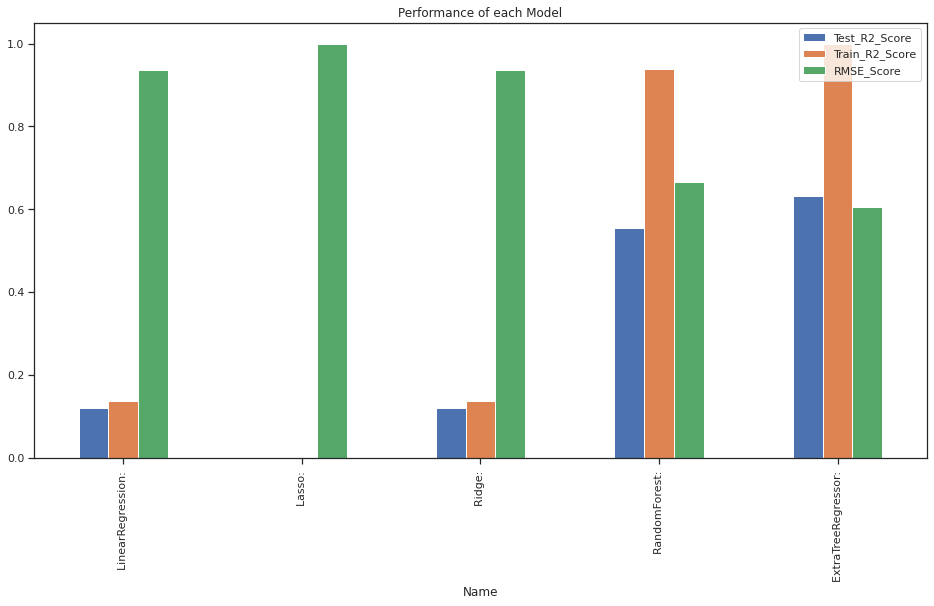

In [95]:
# graphical representation of model implementaion results

model.plot(x="Name", y=['Test_R2_Score' , 'Train_R2_Score' , 'RMSE_Score'], kind="bar" , title = 'Performance of each Model' , figsize= (16,8));

Answer Here.

### 1. Which Evaluation metrics did you consider for a positive business impact and why?

The problem is regression based problem so we does the train time, train R2 score, test R2 score and rmse for the implemented models and we come up with that the ExtraTree Regressor is giving the positive impact on business it take less time than the randomforest and it give near to accuracy result.



### 2. Which ML model did you choose from the above created models as your final prediction model and why?

We implemented the Linear regression, lasso , ridge, randomforest, extratree regressor model from the doing its hyperparameter tunning and the prediction we have find out that the ExtraTree Regressor is giving the best performing model as the RMSE value of the ExtraTree Regressor is 0.606121 which is near to 0.0 compare to other models.

### 3. Explain the model which you have used and the feature importance using any model explainability tool?

We have impelented few regression machine learning models where we find out that the ExtraTreeRegressor is best performing model and we find out the importanat features from that we plot the imporatant feature and come up  with that the humidity attribute is important factor in energy consumption more than that the temperature and weather(windspeed) attributes.
we done hyperparameter tunning on this important feature and find out that the it is best performing as it gives RMSE 0.004 for training and 0.72 for test.

In [96]:
# Get sorted list of features in order of importance
feature_indices = np.argsort(grid_searchET.best_estimator_.feature_importances_)

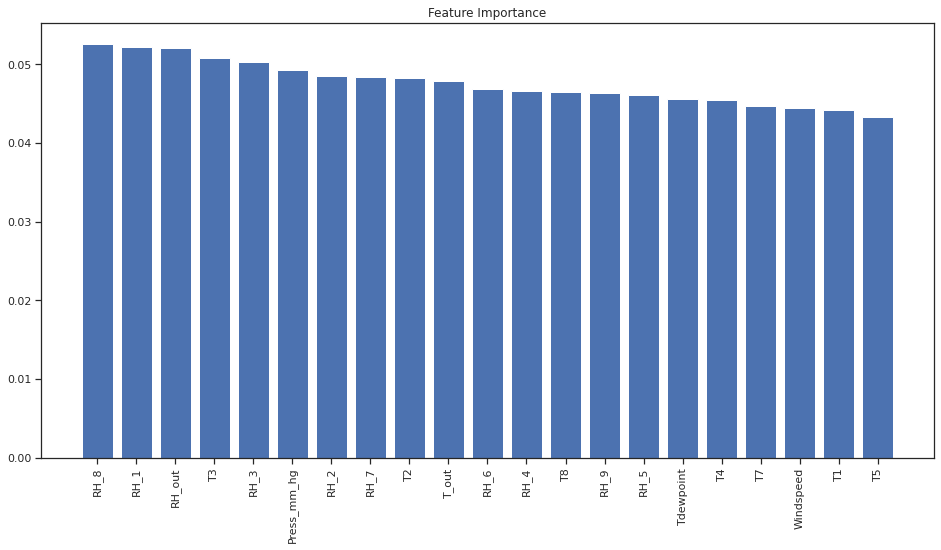

In [97]:
importances = grid_searchET.best_estimator_.feature_importances_
indices = np.argsort(importances)[::-1]
names = [train_X.columns[i] for i in indices]
# Create plot
plt.figure(figsize=(16,8))

# Create plot title
plt.title("Feature Importance")

# Add bars
plt.bar(range(train_X.shape[1]), importances[indices])

# Add feature names as x-axis labels
plt.xticks(range(train_X.shape[1]), names, rotation=90)

# Show plot
plt.show()

In [98]:
# Get top 5 most important feature 
names[0:5]

['RH_8', 'RH_1', 'RH_out', 'T3', 'RH_3']

In [99]:
# Get 5 least important feature 
names[-5:]

['T4', 'T7', 'Windspeed', 'T1', 'T5']

In [100]:
# Reduce test & training set to 5 feature set
train_important_feature = train_X[names[0:5]]
test_important_feature = test_X[names[0:5]]

In [101]:
# Clone the Gridsearch model with his parameter and fit on reduced dataset

from sklearn.base import clone
cloned_model = clone(grid_searchET.best_estimator_)
cloned_model.fit(train_important_feature , train_y)

ExtraTreesRegressor(max_depth=80, max_features='sqrt', n_estimators=150,
                    random_state=40)

In [102]:
# Reduced dataset scores 

print('Training set R2 Score = ', metrics.r2_score(train_y,cloned_model.predict(train_important_feature)))
print('Testing set R2 Score = ', metrics.r2_score(test_y,cloned_model.predict(test_important_feature)))
print('Training set RMSE Score = ', np.sqrt(mean_squared_error(train_y, cloned_model.predict(train_important_feature))))
print('Testing set RMSE Score = ', np.sqrt(mean_squared_error(test_y, cloned_model.predict(test_important_feature))))

Training set R2 Score =  0.9999837366325176
Testing set R2 Score =  0.4751889249428549
Training set RMSE Score =  0.004032786565444871
Testing set RMSE Score =  0.7244384549823022


## ***8.*** ***Future Work (Optional)***

### 1. Save the best performing ml model in a pickle file or joblib file format for deployment process.


In [103]:
# Save the File

### 2. Again Load the saved model file and try to predict unseen data for a sanity check.


In [104]:
# Load the File and predict unseen data.

### ***Congrats! Your model is successfully created and ready for deployment on a live server for a real user interaction !!!***

# **Conclusion**

* The best feature yields in the feature importance graph, where we see that the 
'RH_8' is the most important feature and 'T5' is least important feature.

* The top three important features are 'Humidity' attributes, which is lead to the conclusion that the 'Humidity' affects the power more than the Temperature.

* 'Windspeed' and 'Temperature' features are least important as wind does not affect the power consumption inside the house.

* So the controlling the 'Humidity' inside house may lead to save Energy consumptions.

* 'Extra Tree Regression' found to be the best performing model

* This Dataset has the date time component so the best performance can be achieved by using 'Time Series Analysis' concept.

### ***Hurrah! You have successfully completed your Machine Learning Capstone Project !!!***